# 2.2 Higher Dimensional Real Life Linear Models

We've had a look at fitting some simple polynomials in 1D. But in astronomy, we often have data that is higher dimensional, for example imaging data, multi-dimensional spectra, or 3D images over time. Let's try fitting some higher dimensional data with these principles.

In [2]:
import pickle

import matplotlib.pyplot as plt
import numpy as np

from utils import animate

import seaborn as sns

sns.set_context("talk")
r = pickle.load(open("../files/tpf.p", "rb"))
x, y, ye, row, column = (
    r["time"][:300],
    r["flux"][:300],
    r["flux_err"][:300],
    r["row"][:300],
    r["column"][:300],
)

## TESS Image Time Series

The NASA TESS mission takes image data at a rapid cadence in 27 day sectors, observing approximately half the sky over the course of the year. This data can be used to better understand the variability of stars, or identify transiting exoplanets. However, TESS has a significant systematic where scattered light from the earth and moon is picked up by the cameras.

This animation shows a small cut out of TESS data, where the scattered light is significant at the beginning of the observation. 

In [3]:
animate(y - np.median(y), xlabel="Column Pixel", ylabel="Row Pixel", vmin=-20, vmax=20)

We can build a simple linear model to remove this additive noise source. Let's look at the shape of the data.

In [4]:
y.shape

(300, 15, 16)

There are 300 time cadences, 15 rows, and 16 columns in the dataset. 

In our framework we're only able to fit 1D time-series, and so we will have to reshape this image. Instead of fitting the image as is, let's instead fit each pixel time series.

In [5]:
y[:, np.ones(y.shape[1:], bool)].shape

(300, 240)

This array has the right shape for us to fit individual pixel time series.

We know this scattered background noise is spatial dependent, when we look at the data we can see this is a fairly smooth function in column and row that changes over time. We'll use the row and column positions of each pixel as the vectors for our design matrix. 

In [6]:
print(row.ravel()[:20], "...")
print(column.ravel()[:20], "...")

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1] ...
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15  0  1  2  3] ...


In [7]:
A = np.vstack(
    [np.ones(np.prod(row.shape)), row.ravel(), column.ravel(), (row * column).ravel()]
).T

This design matrix is a simple 1st order, 2D polynomial in row and column. 

You can see that the design matrix has an entry for every pixel.

In [8]:
A.shape

(240, 4)

Let's fit our model! We'll fit to just the first frame of the data for now.

In [9]:
w = np.linalg.solve(A.T.dot(A), A.T.dot(y[0].ravel()))

In [10]:
w

array([190.13824571,   2.27547152,  -1.49809137,   0.40654601])

Now we can generate our model. Note that the model needs to be reshaped so that it has the correct image dimensions. 

In [11]:
model = A.dot(w).reshape(y.shape[1:])

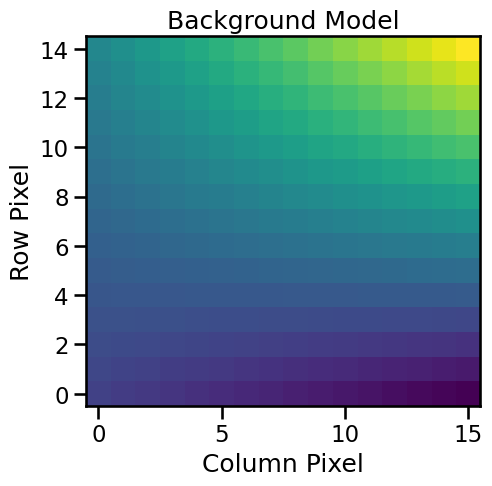

In [12]:
fig, ax = plt.subplots()
plt.imshow(model, origin="lower")
ax.set(xlabel="Column Pixel", ylabel="Row Pixel", title="Background Model");

That's a smooth model! Let's look at the residuals.

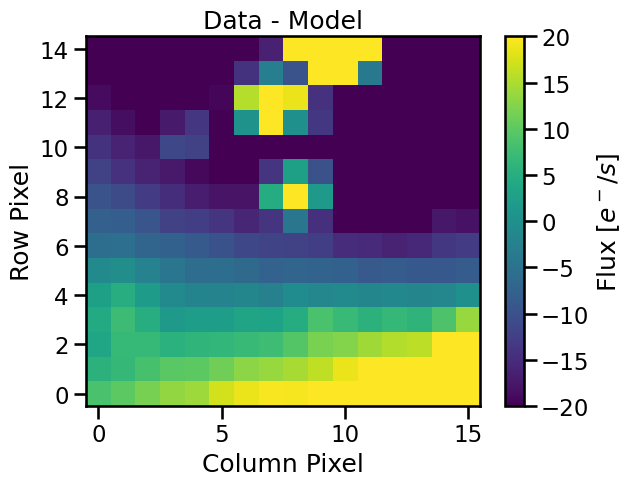

In [13]:
fig, ax = plt.subplots()
im = plt.imshow(y[0] - model, origin="lower", vmin=-20, vmax=20)
cbar = plt.colorbar(im, ax=ax)
cbar.set_label("Flux [$e^-/s$]")
ax.set(xlabel="Column Pixel", ylabel="Row Pixel", title="Data - Model");

Hm. The background pixels -should- be close to zero, but they are actually large, negative values. What's going on?

Well, we fit our model to -all- the pixels in the image. And those pixels with bright stars in the image are actually skewing the fit. The model has no way to fit the bright targets, it can only fit the average. This is not what we want.

There are a few ways we can move forward.

## Idea 1: We can mask out bright pixels.

We've got quite a lot of data, and there aren't many stars in the image. We could try masking out the stars in the image and then fit our model. This will ensure we're not being skewed by the bright pixels. Let's try it.


In [14]:
# I've set this by hand looking at the data, as a reasonable pixel mask
# If you're doing this to your own data, think carefully about how to mask it

# Mask is True anywhere where the flux is less than 150
mask = y[0].ravel() < 210

In [15]:
w = np.linalg.solve(A[mask].T.dot(A[mask]), A[mask].T.dot(y[0].ravel()[mask]))

Ok we've found our best fitting weights! Now let's make our model. Remember we're not going to mask the design matrix this time, because we want to know the value of the model at all pixels.

In [16]:
model = A.dot(w).reshape(y.shape[1:])

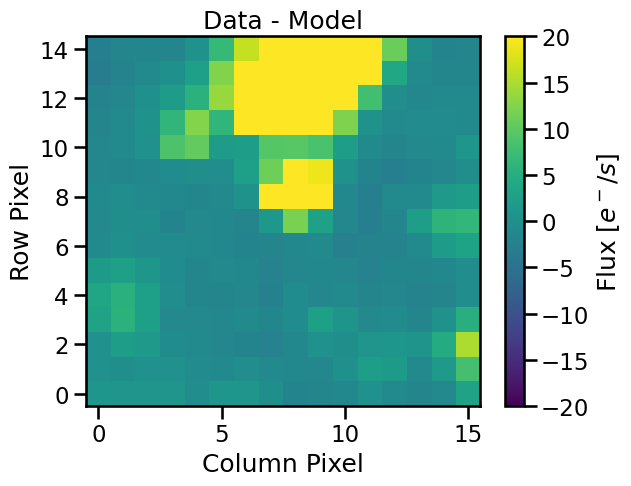

In [17]:
fig, ax = plt.subplots()
im = plt.imshow(y[0] - model, origin="lower", vmin=-20, vmax=20)
cbar = plt.colorbar(im, ax=ax)
cbar.set_label("Flux [$e^-/s$]")
ax.set(xlabel="Column Pixel", ylabel="Row Pixel", title="Data - Model");

Great! Now the model is fitting only the background pixels, and the value of the background pixels is close to zero!

## Idea 2: We could change our model

What if we don't have enough data that we can afford to mask some of it out? Then we're going to need a better model for the data. Let's update our model so that it can flexibly fit around the stars. 

For this TESS data, we have 300 frames of the same patch of sky, which should have approximately the same star scene, but variable amounts of background.

Let's try a model that is our simple polynomial + the average image over time.

In [18]:
avg = y.mean(axis=0)

In [19]:
avg.shape

(15, 16)

Because the average image still has background in it, I'm going to median subtract the average. 

In [20]:
avg = y.mean(axis=0)
avg -= np.median(avg)

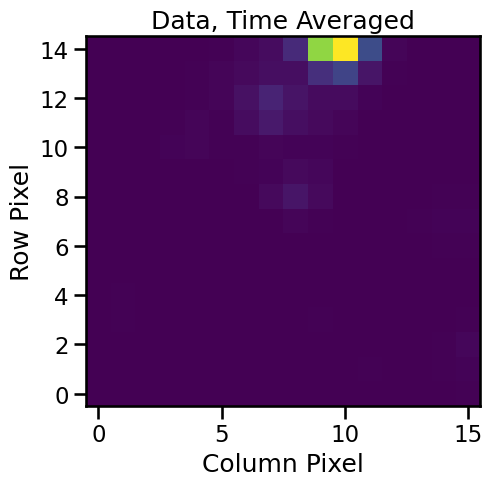

In [21]:
fig, ax = plt.subplots()
plt.imshow(avg, origin="lower")
ax.set(xlabel="Column Pixel", ylabel="Row Pixel", title="Data, Time Averaged");

We'll need a new design matrix

In [22]:
A = np.vstack(
    [
        np.ones(np.prod(row.shape)),
        row.ravel(),
        column.ravel(),
        (row * column).ravel(),
        avg.ravel(),
    ]
).T

In [23]:
A.shape

(240, 5)

Now we have an additional vector which is the average image over time. Let's fit the model again, this time we don't need to mask pixels.

In [24]:
w = np.linalg.solve(A.T.dot(A), A.T.dot(y[0].ravel()))

In [25]:
model = A.dot(w).reshape(y.shape[1:])

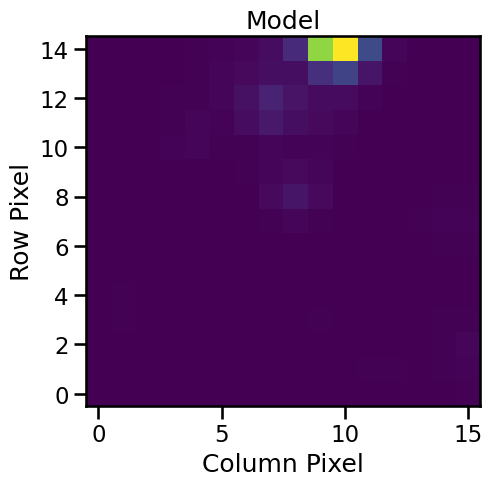

In [26]:
fig, ax = plt.subplots()
plt.imshow(model, origin="lower")
ax.set(xlabel="Column Pixel", ylabel="Row Pixel", title="Model");

Now our model includes the stars, because we've included the average as one of our matrix components. We wanted to do this to allow the model to flexibly fit the background around the stars, but in our case we only want to use the model for the background.

To achieve this, let's use the weights that are for the polynomial coefficients only. Below I make the model using all but the last components of the design matrix, because the last component is the "average" (see above).

In [27]:
model = A[:, :-1].dot(w[:-1]).reshape(y.shape[1:])

In [28]:
model.shape

(15, 16)

The model still has the same number of pixels.

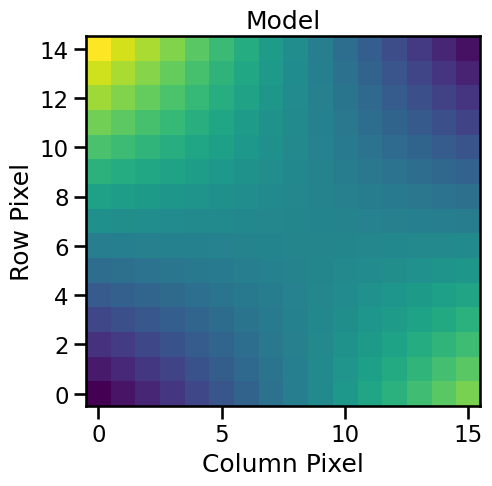

In [29]:
fig, ax = plt.subplots()
plt.imshow(model, origin="lower")
ax.set(xlabel="Column Pixel", ylabel="Row Pixel", title="Model");

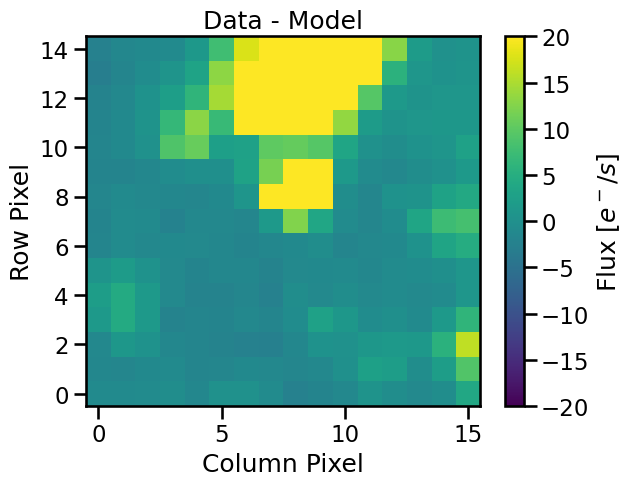

In [30]:
fig, ax = plt.subplots()
im = plt.imshow(y[0] - model, origin="lower", vmin=-20, vmax=20)
cbar = plt.colorbar(im, ax=ax)
cbar.set_label("Flux [$e^-/s$]")
ax.set(xlabel="Column Pixel", ylabel="Row Pixel", title="Data - Model");

Now we've fit the data and removed the background, without the stars skewing the fit. Great!

## Fitting the same model many times

Now that you've seen we can fit a 2D model to a frame, what if we want to fit the same model to many frames?

We can do that easily, first let's do it by iterating.

In [31]:
%%time
ws = np.asarray([np.linalg.solve(A.T.dot(A), A.T.dot(frame.ravel())) for frame in y])

CPU times: user 5.52 ms, sys: 125 µs, total: 5.65 ms
Wall time: 3.7 ms


In [32]:
ws.shape

(300, 5)

I've created weights for every frame in the data. You can see it has shape 300 (number of frames) by 5 (number of components in the model). I've done this by iterating over every frame.

Let's make the model for all of these frames. (Remember, we're only using the first 4 components, because we don't want to include the average.)


In [33]:
model = np.asarray([A[:, :-1].dot(w[:-1]).reshape(y.shape[1:]) for w in ws])

We've made a model with the same shape as the data. Let's look at the residuals.

In [34]:
animate(
    y - np.median(y),
    xlabel="Column Pixel",
    ylabel="Row Pixel",
    title="TPF Data",
    vmin=-20,
    vmax=20,
)

And below is the model itself

In [35]:
animate(
    model - np.median(model),
    xlabel="Column Pixel",
    ylabel="Row Pixel",
    title="TPF Model",
    vmin=-20,
    vmax=20,
)

Let's look at the residuals between the data and the model.

In [36]:
animate(
    y - model,
    xlabel="Column Pixel",
    ylabel="Row Pixel",
    title="Data - Model",
    vmin=-20,
    vmax=20,
)

You can see that we've now removed the changing background! This is excellent, and exactly what we were trying to achieve.

This model is a starting point. We could perhaps improve the model by, for example, folding in the knowledge that frames that are close together in time might have similar parameters. We'll leave that to another exercise for now.